<a href="https://colab.research.google.com/github/ShreyaaChauhan/Document_Image_Table_Detection-/blob/main/Document_Image_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# install dependencies: (use cu111 because colab has CUDA 11.1)
!pip install torch==1.9.0+cu111 torchvision==0.10.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html

# install mmcv-full thus we could use CUDA operators
!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu111/torch1.9.0/index.html

!git clone https://github.com/ShreyaaChauhan/Document_Image_Table_Detection-.git


In [2]:
%cd /content/Document_Image_Table_Detection-

/content/Document_Image_Table_Detection-


In [3]:
!pwd /content/Document_Image_Table_Detection-

/content/Document_Image_Table_Detection-


In [ ]:
!pip install -v -e .
!pip install mmdet

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
!unzip "/content/gdrive/MyDrive/trackA_modern.zip" -d ./data/

In [ ]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
from mmcv import collect_env
collect_env()

{'CUDA available': True,
 'CUDA_HOME': '/usr/local/cuda',
 'GCC': 'x86_64-linux-gnu-gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0',
 'GPU 0': 'Tesla P100-PCIE-16GB',
 'MMCV': '1.5.3',
 'MMCV CUDA Compiler': '11.1',
 'MMCV Compiler': 'GCC 7.3',
 'NVCC': 'Cuda compilation tools, release 11.1, V11.1.105',
 'OpenCV': '4.1.2',
 'PyTorch': '1.9.0+cu111',
 'PyTorch compiling details': 'PyTorch built with:\n  - GCC 7.3\n  - C++ Version: 201402\n  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications\n  - Intel(R) MKL-DNN v2.1.2 (Git Hash 98be7e8afa711dc9b66c8ff3504129cb82013cdb)\n  - OpenMP 201511 (a.k.a. OpenMP 4.5)\n  - NNPACK is enabled\n  - CPU capability usage: AVX2\n  - CUDA Runtime 11.1\n  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_70,code=sm_70;-gencode;arch=compute_75,code=sm_75;-gencode;arch=compute_80,code=sm_80;-genco

In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

# Check MMDetection installation
import mmdet
print(mmdet.__version__)

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(get_compiling_cuda_version())
print(get_compiler_version())

1.9.0+cu111 True
2.25.0
11.1
GCC 7.3


In [ ]:
# We download the pre-trained checkpoints for inference and finetuning.
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/faster_rcnn/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco_20210526_095054-1f77628b.pth \
      -O checkpoints/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco_20210526_095054-1f77628b.pth

--2022-06-29 09:49:55--  https://download.openmmlab.com/mmdetection/v2.0/faster_rcnn/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco_20210526_095054-1f77628b.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.254.186.233
Connecting to download.openmmlab.com (download.openmmlab.com)|47.254.186.233|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 167291982 (160M) [application/octet-stream]
Saving to: ‘checkpoints/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco_20210526_095054-1f77628b.pth’

checkpoints/faster_ 100%[===================>] 159.54M  7.55MB/s    in 21s     

2022-06-29 09:50:17 (7.46 MB/s) - ‘checkpoints/faster_rcnn_r50_caffe_fpn_mstrain_3x_coco_20210526_095054-1f77628b.pth’ saved [167291982/167291982]



In [ ]:
%%writefile configs/mask_rcnn/mask_rcnn_icdar2019.py
# model settings

model = dict(
    type='MaskRCNN',
    backbone=dict(
        type='ResNet',
        depth=101,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=-1,
        zero_init_residual=False,
        norm_cfg = dict(type='GN', num_groups=32, requires_grad=True),
        norm_eval=True,
        style='pytorch',
        #init_cfg=dict(type='Pretrained', checkpoint='torchvision://resnet50'),
        init_cfg=None
        ),
    neck=dict(
        type='FPN',
        norm_cfg=dict(type='GN', num_groups=32, requires_grad=True),
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        num_outs=5),
    rpn_head=dict(
        type='RPNHead',
        in_channels=256,
        feat_channels=256,
        anchor_generator=dict(
            type='AnchorGenerator',
            scales=[8],
            ratios=[0.5, 1.0, 2.0],
            strides=[4, 8, 16, 32, 64]),
        bbox_coder=dict(
            type='DeltaXYWHBBoxCoder',
            target_means=[.0, .0, .0, .0],
            target_stds=[1.0, 1.0, 1.0, 1.0]),
        loss_cls=dict(
            type='CrossEntropyLoss', use_sigmoid=True, loss_weight=1.0),
        loss_bbox=dict(type='L1Loss', loss_weight=1.0)),
    roi_head=dict(
        type='StandardRoIHead',
        bbox_roi_extractor=dict(
            type='SingleRoIExtractor',
            roi_layer=dict(type='RoIAlign', output_size=7, sampling_ratio=0),
            out_channels=256,
            featmap_strides=[4, 8, 16, 32]),
        bbox_head=dict(
            type='Shared4Conv1FCBBoxHead',
            norm_cfg=dict(type='GN', num_groups=32, requires_grad=True),
            in_channels=256,
            fc_out_channels=1024,
            roi_feat_size=7,
            num_classes=1,
            bbox_coder=dict(
                type='DeltaXYWHBBoxCoder',
                target_means=[0., 0., 0., 0.],
                target_stds=[0.1, 0.1, 0.2, 0.2]),
            reg_class_agnostic=False,
            loss_cls=dict(
                type='CrossEntropyLoss', use_sigmoid=False, loss_weight=1.0),
            loss_bbox=dict(type='L1Loss', loss_weight=1.0)),
        mask_roi_extractor=dict(
            type='SingleRoIExtractor',
            roi_layer=dict(type='RoIAlign', output_size=14, sampling_ratio=0),
            out_channels=256,
            featmap_strides=[4, 8, 16, 32]),
        mask_head=dict(
            type='FCNMaskHead',
             norm_cfg=dict(type='GN', num_groups=32, requires_grad=True),
            num_convs=4,
            in_channels=256,
            conv_out_channels=256,
            num_classes=1,
            loss_mask=dict(
                type='CrossEntropyLoss', use_mask=True, loss_weight=1.0))),
    # model training and testing settings
    train_cfg=dict(
        rpn=dict(
            assigner=dict(
                type='MaxIoUAssigner',
                pos_iou_thr=0.7,
                neg_iou_thr=0.3,
                min_pos_iou=0.3,
                match_low_quality=True,
                ignore_iof_thr=-1),
            sampler=dict(
                type='RandomSampler',
                num=256,
                pos_fraction=0.5,
                neg_pos_ub=-1,
                add_gt_as_proposals=False),
            allowed_border=-1,
            pos_weight=-1,
            debug=False),
        rpn_proposal=dict(
            nms_pre=2000,
            max_per_img=1000,
            nms=dict(type='nms', iou_threshold=0.7),
            min_bbox_size=0),
        rcnn=dict(
            assigner=dict(
                type='MaxIoUAssigner',
                pos_iou_thr=0.5,
                neg_iou_thr=0.5,
                min_pos_iou=0.5,
                match_low_quality=True,
                ignore_iof_thr=-1),
            sampler=dict(
                type='RandomSampler',
                num=512,
                pos_fraction=0.25,
                neg_pos_ub=-1,
                add_gt_as_proposals=True),
            mask_size=28,
            pos_weight=-1,
            debug=False)),
    test_cfg=dict(
        rpn=dict(
            nms_pre=1000,
            max_per_img=1000,
            nms=dict(type='nms', iou_threshold=0.7),
            min_bbox_size=0),
        rcnn=dict(
            score_thr=0.05,
            nms=dict(type='nms', iou_threshold=0.5),
            max_per_img=100,
            mask_thr_binary=0.5)))

dataset_type = 'CocoDataset'
data_root = 'data/trackA_modern/'
img_norm_cfg = dict(
    mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True)


train_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='LoadAnnotations', with_bbox=True, with_mask=True),
    dict(type='Resize', img_scale=(1333, 800), keep_ratio=True),
    dict(type='RandomFlip', flip_ratio=0.5),
    dict(type='Normalize', **img_norm_cfg),
    dict(type='Pad', size_divisor=32),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_bboxes', 'gt_labels', 'gt_masks']),
]
test_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='MultiScaleFlipAug',
        img_scale=(1333, 800),
        flip=False,
        transforms=[
            dict(type='Resize', keep_ratio=True),
            dict(type='RandomFlip'),
            dict(type='Normalize', **img_norm_cfg),
            dict(type='Pad', size_divisor=32),
            dict(type='ImageToTensor', keys=['img']),
            dict(type='Collect', keys=['img']),
        ])
]

# Use RepeatDataset to speed up training
data = dict(
    samples_per_gpu=2,
    workers_per_gpu=2,
    train=dict(
        type=dataset_type,
        ann_file=data_root + 'train.json',
        img_prefix=data_root + 'train/',
        pipeline=train_pipeline,
        classes = ('table',),
        ),
    val=dict(
        type=dataset_type,
        ann_file=data_root + 'test.json',
        img_prefix=data_root + 'test/',
        pipeline=test_pipeline,
        classes = ('table',),
        ),
    test=dict(
        type=dataset_type,
        ann_file=data_root + 'test.json',
        img_prefix=data_root + 'test/',
        pipeline=test_pipeline),
        classes = ('table',),
        )
evaluation = dict(interval=1, metric=['bbox', 'segm'])
# optimizer
optimizer = dict(type='SGD', lr=0.02, momentum=0.9, weight_decay=0.0001,paramwise_cfg=dict(norm_decay_mult=0))
optimizer_config = dict(grad_clip=None)
# learning policy
lr_config = dict(
    policy='step',
    warmup='linear',
    warmup_iters=500,
    warmup_ratio=0.01,
    step=[65, 71])
runner = dict(type='EpochBasedRunner', max_epochs=73)


checkpoint_config = dict(interval=1)
# yapf:disable
log_config = dict(
    interval=50,
    hooks=[
        dict(type='TextLoggerHook'),
        dict(type='TensorboardLoggerHook')
    ])
# yapf:enable
custom_hooks = [dict(type='NumClassCheckHook')]

dist_params = dict(backend='nccl')
log_level = 'INFO'
load_from = None
resume_from = None
workflow = [('train', 1)]

# disable opencv multithreading to avoid system being overloaded
opencv_num_threads = 0
# set multi-process start method as `fork` to speed up the training
mp_start_method = 'fork'

# Default setting for scaling LR automatically
#   - `enable` means enable scaling LR automatically
#       or not by default.
#   - `base_batch_size` = (8 GPUs) x (2 samples per GPU).
auto_scale_lr = dict(enable=False, base_batch_size=16)


Overwriting configs/mask_rcnn/mask_rcnn_icdar2019.py


In [ ]:
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector
from mmdet.apis import set_random_seed
import mmcv
import os.path as osp


config = 'configs/mask_rcnn/mask_rcnn_icdar2019.py'
# Set the device to be used for evaluation
device='cuda:0'
# Load the config
config = mmcv.Config.fromfile(config)
# Set pretrained to be None since we do not need pretrained model here
config.model.pretrained = None
config.device='cuda'
# Set up working dir to save files and logs.
config.work_dir = './exps'
# Set seed thus the results are more reproducible
config.seed = 0
set_random_seed(0, deterministic=False)
config.gpu_ids = range(1)

# Build dataset
datasets = [build_dataset(config.data.train)]
# Build the detector
model = build_detector( config.model, train_cfg=config.get('train_cfg'), test_cfg=config.get('test_cfg'))
# We need to set the model's cfg for inference
model.cfg = config
# Add an attribute for visualization convenience
model.CLASSES = ('table',)
#print(model.CLASSES)
# Convert the model to GPU
model.to(device)
# Create work_dir
mmcv.mkdir_or_exist(osp.abspath(config.work_dir))
train_detector(model, datasets, config, distributed=False, validate=True)

2022-06-29 16:35:26,500 - mmdet - INFO - Epoch [1][50/301]	lr: 2.140e-03, eta: 3:15:19, time: 0.535, data_time: 0.067, memory: 6500, loss_rpn_cls: 0.2474, loss_rpn_bbox: 0.0418, loss_cls: 0.1367, acc: 97.1133, loss_bbox: 0.0541, loss_mask: 0.5757, loss: 1.0558
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f4acc85d680>
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py", line 1328, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py", line 1301, in _shutdown_workers
    w.join(timeout=_utils.MP_STATUS_CHECK_INTERVAL)
  File "/usr/lib/python3.7/multiprocessing/process.py", line 140, in join
    res = self._popen.wait(timeout)
  File "/usr/lib/python3.7/multiprocessing/popen_fork.py", line 45, in wait
    if not wait([self.sentinel], timeout):
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 921, in wait
    ready = s

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-67-e4fc97968cba>", line 37, in <module>
    train_detector(model, datasets, config, distributed=False, validate=True)
  File "/content/Document_Image_Table_Detection-/mmdet/apis/train.py", line 244, in train_detector
    runner.run(data_loaders, cfg.workflow)
  File "/usr/local/lib/python3.7/dist-packages/mmcv/runner/epoch_based_runner.py", line 130, in run
    epoch_runner(data_loaders[i], **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/mmcv/runner/epoch_based_runner.py", line 52, in train
    self.call_hook('after_train_iter')
  File "/usr/local/lib/python3.7/dist-packages/mmcv/runner/base_runner.py", line 309, in call_hook
    getattr(hook, fn_name)(self)
  File "/usr/local/lib/python3.7/dist-packages/mmcv/runner/hooks/optimizer.py", line 64, in after_train_ite

KeyboardInterrupt: ignored

In [ ]:
# Use the detector to do inference
img = '/content/Document_Image_Table_Detection-/data/trackA_modern/test/cTDaR_t10012.jpg'
result = inference_detector(model, img)

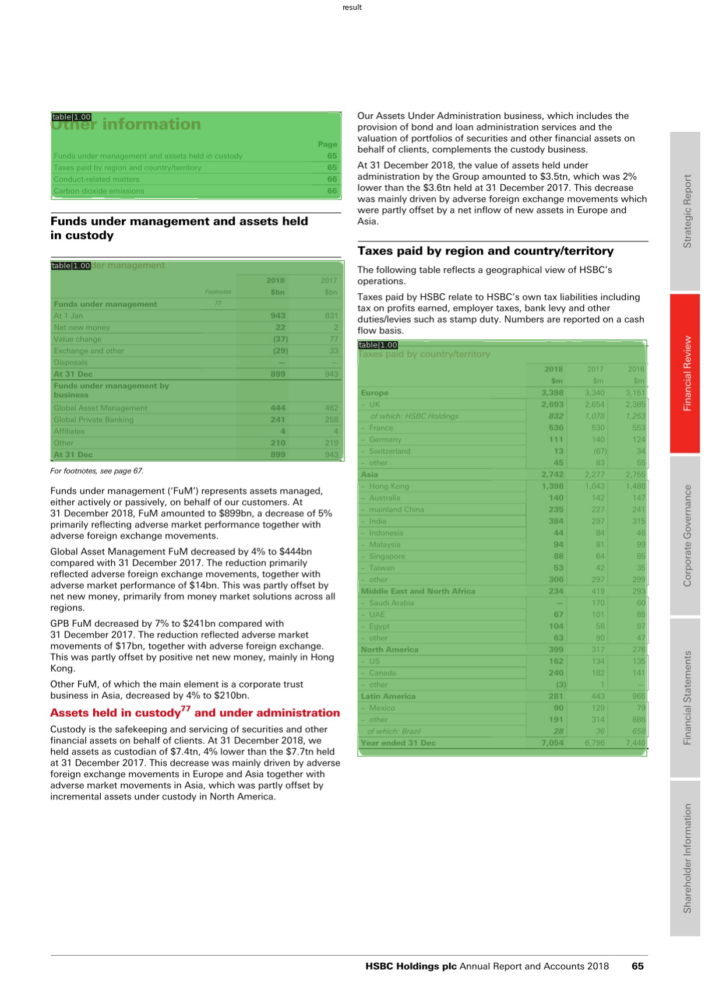

In [ ]:
# Let's plot the result

show_result_pyplot(model, img, result, score_thr=0.92)

In [ ]:
!python tools/test.py configs/mask_rcnn/mask_rcnn_icdar2019.py /content/Document_Image_Table_Detection-/exps/epoch_73.pth --show

/content/Document_Image_Table_Detection-/mmdet/utils/setup_env.py:39: UserWarning: Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed.
  f'Setting OMP_NUM_THREADS environment variable for each process '
/content/Document_Image_Table_Detection-/mmdet/utils/setup_env.py:49: UserWarning: Setting MKL_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed.
  f'Setting MKL_NUM_THREADS environment variable for each process '
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
load checkpoint from local path: /content/Document_Image_Table_Detection-/exps/epoch_73.pth
[                                                  ] 0/240, elapsed: 0s, ETA:/usr/local/lib/python3.7/dis

In [ ]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir ./exps

<IPython.core.display.Javascript object>

/usr/lib/python3.7/subprocess.py:883: ResourceWarning: subprocess 4897 is still running
  ResourceWarning, source=self)


In [9]:
%%writefile configs/mask_rcnn/mask_rcnn_dit_icdar2019.py
# model settings

model = dict(
    type='MaskRCNN',
    backbone=dict(
        type='ResNet',
        depth=101,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=-1,
        zero_init_residual=False,
        norm_cfg = dict(type='GN', num_groups=32, requires_grad=True),
        norm_eval=True,
        style='pytorch',
        init_cfg=dict(type='Pretrained', checkpoint='/content/gdrive/MyDrive/dit-base-224-p16-500k-62d53a.pth'),
        ),
    neck=dict(
        type='FPN',
        norm_cfg=dict(type='GN', num_groups=32, requires_grad=True),
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        num_outs=5),
    rpn_head=dict(
        type='RPNHead',
        in_channels=256,
        feat_channels=256,
        anchor_generator=dict(
            type='AnchorGenerator',
            scales=[8],
            ratios=[0.5, 1.0, 2.0],
            strides=[4, 8, 16, 32, 64]),
        bbox_coder=dict(
            type='DeltaXYWHBBoxCoder',
            target_means=[.0, .0, .0, .0],
            target_stds=[1.0, 1.0, 1.0, 1.0]),
        loss_cls=dict(
            type='CrossEntropyLoss', use_sigmoid=True, loss_weight=1.0),
        loss_bbox=dict(type='L1Loss', loss_weight=1.0)),
    roi_head=dict(
        type='StandardRoIHead',
        bbox_roi_extractor=dict(
            type='SingleRoIExtractor',
            roi_layer=dict(type='RoIAlign', output_size=7, sampling_ratio=0),
            out_channels=256,
            featmap_strides=[4, 8, 16, 32]),
        bbox_head=dict(
            type='Shared4Conv1FCBBoxHead',
            norm_cfg=dict(type='GN', num_groups=32, requires_grad=True),
            in_channels=256,
            fc_out_channels=1024,
            roi_feat_size=7,
            num_classes=1,
            bbox_coder=dict(
                type='DeltaXYWHBBoxCoder',
                target_means=[0., 0., 0., 0.],
                target_stds=[0.1, 0.1, 0.2, 0.2]),
            reg_class_agnostic=False,
            loss_cls=dict(
                type='CrossEntropyLoss', use_sigmoid=False, loss_weight=1.0),
            loss_bbox=dict(type='L1Loss', loss_weight=1.0)),
        mask_roi_extractor=dict(
            type='SingleRoIExtractor',
            roi_layer=dict(type='RoIAlign', output_size=14, sampling_ratio=0),
            out_channels=256,
            featmap_strides=[4, 8, 16, 32]),
        mask_head=dict(
            type='FCNMaskHead',
             norm_cfg=dict(type='GN', num_groups=32, requires_grad=True),
            num_convs=4,
            in_channels=256,
            conv_out_channels=256,
            num_classes=1,
            loss_mask=dict(
                type='CrossEntropyLoss', use_mask=True, loss_weight=1.0))),
    # model training and testing settings
    train_cfg=dict(
        rpn=dict(
            assigner=dict(
                type='MaxIoUAssigner',
                pos_iou_thr=0.7,
                neg_iou_thr=0.3,
                min_pos_iou=0.3,
                match_low_quality=True,
                ignore_iof_thr=-1),
            sampler=dict(
                type='RandomSampler',
                num=256,
                pos_fraction=0.5,
                neg_pos_ub=-1,
                add_gt_as_proposals=False),
            allowed_border=-1,
            pos_weight=-1,
            debug=False),
        rpn_proposal=dict(
            nms_pre=2000,
            max_per_img=1000,
            nms=dict(type='nms', iou_threshold=0.7),
            min_bbox_size=0),
        rcnn=dict(
            assigner=dict(
                type='MaxIoUAssigner',
                pos_iou_thr=0.5,
                neg_iou_thr=0.5,
                min_pos_iou=0.5,
                match_low_quality=True,
                ignore_iof_thr=-1),
            sampler=dict(
                type='RandomSampler',
                num=512,
                pos_fraction=0.25,
                neg_pos_ub=-1,
                add_gt_as_proposals=True),
            mask_size=28,
            pos_weight=-1,
            debug=False)),
    test_cfg=dict(
        rpn=dict(
            nms_pre=1000,
            max_per_img=1000,
            nms=dict(type='nms', iou_threshold=0.7),
            min_bbox_size=0),
        rcnn=dict(
            score_thr=0.05,
            nms=dict(type='nms', iou_threshold=0.5),
            max_per_img=100,
            mask_thr_binary=0.5)))

dataset_type = 'CocoDataset'
data_root = 'data/trackA_modern/'
img_norm_cfg = dict(
    mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True)


train_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='LoadAnnotations', with_bbox=True, with_mask=True),
    dict(type='Resize', img_scale=(1333, 800), keep_ratio=True),
    dict(type='RandomFlip', flip_ratio=0.5),
    dict(type='Normalize', **img_norm_cfg),
    dict(type='Pad', size_divisor=32),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_bboxes', 'gt_labels', 'gt_masks']),
]
test_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='MultiScaleFlipAug',
        img_scale=(1333, 800),
        flip=False,
        transforms=[
            dict(type='Resize', keep_ratio=True),
            dict(type='RandomFlip'),
            dict(type='Normalize', **img_norm_cfg),
            dict(type='Pad', size_divisor=32),
            dict(type='ImageToTensor', keys=['img']),
            dict(type='Collect', keys=['img']),
        ])
]

# Use RepeatDataset to speed up training
data = dict(
    samples_per_gpu=2,
    workers_per_gpu=2,
    train=dict(
        type=dataset_type,
        ann_file=data_root + 'train.json',
        img_prefix=data_root + 'train/',
        pipeline=train_pipeline,
        classes = ('table',),
        ),
    val=dict(
        type=dataset_type,
        ann_file=data_root + 'test.json',
        img_prefix=data_root + 'test/',
        pipeline=test_pipeline,
        classes = ('table',),
        ),
    test=dict(
        type=dataset_type,
        ann_file=data_root + 'test.json',
        img_prefix=data_root + 'test/',
        pipeline=test_pipeline),
        classes = ('table',),
        )
evaluation = dict(interval=1, metric=['bbox', 'segm'])
# optimizer
optimizer = dict(type='SGD', lr=0.002, momentum=0.9, weight_decay=0.0001,paramwise_cfg=dict(norm_decay_mult=0))
optimizer_config = dict(grad_clip=None)
# learning policy
lr_config = dict(
    policy='step',
    warmup='linear',
    warmup_iters=500,
    warmup_ratio=0.01,
    step=[65, 71])
runner = dict(type='EpochBasedRunner', max_epochs=30)


checkpoint_config = dict(interval=1)
# yapf:disable
log_config = dict(
    interval=50,
    hooks=[
        dict(type='TextLoggerHook'),
        dict(type='TensorboardLoggerHook')
    ])
# yapf:enable
custom_hooks = [dict(type='NumClassCheckHook')]

dist_params = dict(backend='nccl')
log_level = 'INFO'
load_from = None
resume_from = None
workflow = [('train', 1)]

# disable opencv multithreading to avoid system being overloaded
opencv_num_threads = 0
# set multi-process start method as `fork` to speed up the training
mp_start_method = 'fork'

# Default setting for scaling LR automatically
#   - `enable` means enable scaling LR automatically
#       or not by default.
#   - `base_batch_size` = (8 GPUs) x (2 samples per GPU).
auto_scale_lr = dict(enable=False, base_batch_size=16)


Overwriting configs/mask_rcnn/mask_rcnn_dit_icdar2019.py


In [10]:
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector
from mmdet.apis import set_random_seed
import mmcv
import os.path as osp


config = 'configs/mask_rcnn/mask_rcnn_dit_icdar2019.py'
# Set the device to be used for evaluation
device='cuda:0'
# Load the config
config = mmcv.Config.fromfile(config)
# Set pretrained to be None since we do not need pretrained model here
#config.model.pretrained = None
config.device='cuda'
# Set up working dir to save files and logs.
config.work_dir = './exps'
# Set seed thus the results are more reproducible
config.seed = 0
set_random_seed(0, deterministic=False)
config.gpu_ids = range(1)

# Build dataset
datasets = [build_dataset(config.data.train)]
# Build the detector
model = build_detector( config.model, train_cfg=config.get('train_cfg'), test_cfg=config.get('test_cfg'))
# We need to set the model's cfg for inference
model.cfg = config
# Add an attribute for visualization convenience
model.CLASSES = ('table',)
#print(model.CLASSES)
# Convert the model to GPU
model.to(device)
# Create work_dir
mmcv.mkdir_or_exist(osp.abspath(config.work_dir))
train_detector(model, datasets, config, distributed=False, validate=True)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


2022-07-16 12:21:33,844 - mmdet - INFO - Automatic scaling of learning rate (LR) has been disabled.
INFO:mmdet:Automatic scaling of learning rate (LR) has been disabled.
2022-07-16 12:21:33,900 - mmdet - INFO - Start running, host: root@bd826e28d844, work_dir: /content/Document_Image_Table_Detection-/exps
INFO:mmdet:Start running, host: root@bd826e28d844, work_dir: /content/Document_Image_Table_Detection-/exps
2022-07-16 12:21:33,906 - mmdet - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) StepLrUpdaterHook                  
(NORMAL      ) CheckpointHook                     
(LOW         ) EvalHook                           
(VERY_LOW    ) TextLoggerHook                     
(VERY_LOW    ) TensorboardLoggerHook              
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) StepLrUpdaterHook                  
(NORMAL      ) NumClassCheckHook                  
(LOW         ) IterTimerHook                      
(LOW         ) EvalHook            

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


2022-07-16 12:22:07,235 - mmdet - INFO - Epoch [1][50/301]	lr: 2.140e-04, eta: 1:39:39, time: 0.666, data_time: 0.064, memory: 7796, loss_rpn_cls: 0.5360, loss_rpn_bbox: 0.0450, loss_cls: 0.2060, acc: 88.5156, loss_bbox: 0.0320, loss_mask: 0.6531, loss: 1.4721
INFO:mmdet:Epoch [1][50/301]	lr: 2.140e-04, eta: 1:39:39, time: 0.666, data_time: 0.064, memory: 7796, loss_rpn_cls: 0.5360, loss_rpn_bbox: 0.0450, loss_cls: 0.2060, acc: 88.5156, loss_bbox: 0.0320, loss_mask: 0.6531, loss: 1.4721
2022-07-16 12:22:37,924 - mmdet - INFO - Epoch [1][100/301]	lr: 4.120e-04, eta: 1:35:13, time: 0.614, data_time: 0.018, memory: 7796, loss_rpn_cls: 0.1754, loss_rpn_bbox: 0.0329, loss_cls: 0.1032, acc: 97.6152, loss_bbox: 0.0871, loss_mask: 0.5835, loss: 0.9821
INFO:mmdet:Epoch [1][100/301]	lr: 4.120e-04, eta: 1:35:13, time: 0.614, data_time: 0.018, memory: 7796, loss_rpn_cls: 0.1754, loss_rpn_bbox: 0.0329, loss_cls: 0.1032, acc: 97.6152, loss_bbox: 0.0871, loss_mask: 0.5835, loss: 0.9821
2022-07-16 12:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 2.1 task/s, elapsed: 116s, ETA:     0s

2022-07-16 12:26:40,996 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.23s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 12:26:42,250 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.027
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.115
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.003
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.028
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.245
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.245
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.245
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.78s).
Accumulating evaluation results...
DONE (t=0.19s).


INFO:mmdet:Evaluating segm...
/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


Loading and preparing results...
DONE (t=0.27s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:26:44,184 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.030
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.119
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.004
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=1.17s).
Accumulating evaluation results...
DONE (t=0.20s).


2022-07-16 12:26:44,208 - mmdet - INFO - Epoch(val) [1][240]	bbox_mAP: 0.0270, bbox_mAP_50: 0.1150, bbox_mAP_75: 0.0030, bbox_mAP_s: -1.0000, bbox_mAP_m: 0.0000, bbox_mAP_l: 0.0280, bbox_mAP_copypaste: 0.027 0.115 0.003 -1.000 0.000 0.028, segm_mAP: 0.0300, segm_mAP_50: 0.1190, segm_mAP_75: 0.0040, segm_mAP_s: -1.0000, segm_mAP_m: 0.0000, segm_mAP_l: 0.0300, segm_mAP_copypaste: 0.030 0.119 0.004 -1.000 0.000 0.030
INFO:mmdet:Epoch(val) [1][240]	bbox_mAP: 0.0270, bbox_mAP_50: 0.1150, bbox_mAP_75: 0.0030, bbox_mAP_s: -1.0000, bbox_mAP_m: 0.0000, bbox_mAP_l: 0.0280, bbox_mAP_copypaste: 0.027 0.115 0.003 -1.000 0.000 0.028, segm_mAP: 0.0300, segm_mAP_50: 0.1190, segm_mAP_75: 0.0040, segm_mAP_s: -1.0000, segm_mAP_m: 0.0000, segm_mAP_l: 0.0300, segm_mAP_copypaste: 0.030 0.119 0.004 -1.000 0.000 0.030
2022-07-16 12:27:17,245 - mmdet - INFO - Epoch [2][50/301]	lr: 1.406e-03, eta: 1:30:29, time: 0.660, data_time: 0.063, memory: 7796, loss_rpn_cls: 0.0350, loss_rpn_bbox: 0.0380, loss_cls: 0.0828

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 4.2 task/s, elapsed: 57s, ETA:     0s

2022-07-16 12:30:53,829 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 12:30:54,300 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.160
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.415
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.088
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.161
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.379
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.379
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.379
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.37s).
Accumulating evaluation results...
DONE (t=0.08s).
Loading and preparing results...


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:30:55,094 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.162
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.417
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.095
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.52s).
Accumulating evaluation results...
DONE (t=0.09s).


2022-07-16 12:31:28,438 - mmdet - INFO - Epoch [3][50/301]	lr: 2.000e-03, eta: 1:27:18, time: 0.666, data_time: 0.065, memory: 7872, loss_rpn_cls: 0.0244, loss_rpn_bbox: 0.0387, loss_cls: 0.0766, acc: 97.4570, loss_bbox: 0.0801, loss_mask: 0.3029, loss: 0.5227
INFO:mmdet:Epoch [3][50/301]	lr: 2.000e-03, eta: 1:27:18, time: 0.666, data_time: 0.065, memory: 7872, loss_rpn_cls: 0.0244, loss_rpn_bbox: 0.0387, loss_cls: 0.0766, acc: 97.4570, loss_bbox: 0.0801, loss_mask: 0.3029, loss: 0.5227
2022-07-16 12:31:58,933 - mmdet - INFO - Epoch [3][100/301]	lr: 2.000e-03, eta: 1:26:37, time: 0.610, data_time: 0.016, memory: 7872, loss_rpn_cls: 0.0187, loss_rpn_bbox: 0.0257, loss_cls: 0.0677, acc: 97.6445, loss_bbox: 0.0740, loss_mask: 0.2993, loss: 0.4853
INFO:mmdet:Epoch [3][100/301]	lr: 2.000e-03, eta: 1:26:37, time: 0.610, data_time: 0.016, memory: 7872, loss_rpn_cls: 0.0187, loss_rpn_bbox: 0.0257, loss_cls: 0.0677, acc: 97.6445, loss_bbox: 0.0740, loss_mask: 0.2993, loss: 0.4853
2022-07-16 12:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 4.5 task/s, elapsed: 54s, ETA:     0s

2022-07-16 12:35:00,819 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 12:35:01,186 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.243
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.514
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.211
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.246
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.460
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.460
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.460
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.28s).
Accumulating evaluation results...
DONE (t=0.06s).
Loading and preparing results...


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


DONE (t=0.09s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:35:01,798 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.243
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.512
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.204
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.39s).
Accumulating evaluation results...
DONE (t=0.07s).


2022-07-16 12:35:35,833 - mmdet - INFO - Epoch [4][50/301]	lr: 2.000e-03, eta: 1:24:10, time: 0.680, data_time: 0.064, memory: 7872, loss_rpn_cls: 0.0197, loss_rpn_bbox: 0.0246, loss_cls: 0.0621, acc: 97.6582, loss_bbox: 0.0728, loss_mask: 0.2420, loss: 0.4212
INFO:mmdet:Epoch [4][50/301]	lr: 2.000e-03, eta: 1:24:10, time: 0.680, data_time: 0.064, memory: 7872, loss_rpn_cls: 0.0197, loss_rpn_bbox: 0.0246, loss_cls: 0.0621, acc: 97.6582, loss_bbox: 0.0728, loss_mask: 0.2420, loss: 0.4212
2022-07-16 12:36:07,364 - mmdet - INFO - Epoch [4][100/301]	lr: 2.000e-03, eta: 1:23:41, time: 0.631, data_time: 0.017, memory: 7872, loss_rpn_cls: 0.0174, loss_rpn_bbox: 0.0289, loss_cls: 0.0589, acc: 97.8984, loss_bbox: 0.0686, loss_mask: 0.2494, loss: 0.4232
INFO:mmdet:Epoch [4][100/301]	lr: 2.000e-03, eta: 1:23:41, time: 0.631, data_time: 0.017, memory: 7872, loss_rpn_cls: 0.0174, loss_rpn_bbox: 0.0289, loss_cls: 0.0589, acc: 97.8984, loss_bbox: 0.0686, loss_mask: 0.2494, loss: 0.4232
2022-07-16 12:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 3.4 task/s, elapsed: 70s, ETA:     0s

2022-07-16 12:39:26,021 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 12:39:26,497 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.635
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.321
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.340
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.541
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.541
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.541
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.37s).
Accumulating evaluation results...
DONE (t=0.08s).
Loading and preparing results...


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:39:27,326 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.370
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.644
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.388
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.55s).
Accumulating evaluation results...
DONE (t=0.08s).


2022-07-16 12:40:01,425 - mmdet - INFO - Epoch [5][50/301]	lr: 2.000e-03, eta: 1:21:11, time: 0.681, data_time: 0.066, memory: 8084, loss_rpn_cls: 0.0199, loss_rpn_bbox: 0.0306, loss_cls: 0.0740, acc: 97.4238, loss_bbox: 0.0786, loss_mask: 0.2034, loss: 0.4065
INFO:mmdet:Epoch [5][50/301]	lr: 2.000e-03, eta: 1:21:11, time: 0.681, data_time: 0.066, memory: 8084, loss_rpn_cls: 0.0199, loss_rpn_bbox: 0.0306, loss_cls: 0.0740, acc: 97.4238, loss_bbox: 0.0786, loss_mask: 0.2034, loss: 0.4065
2022-07-16 12:40:32,159 - mmdet - INFO - Epoch [5][100/301]	lr: 2.000e-03, eta: 1:20:36, time: 0.615, data_time: 0.015, memory: 8084, loss_rpn_cls: 0.0129, loss_rpn_bbox: 0.0260, loss_cls: 0.0534, acc: 97.9277, loss_bbox: 0.0623, loss_mask: 0.1937, loss: 0.3483
INFO:mmdet:Epoch [5][100/301]	lr: 2.000e-03, eta: 1:20:36, time: 0.615, data_time: 0.015, memory: 8084, loss_rpn_cls: 0.0129, loss_rpn_bbox: 0.0260, loss_cls: 0.0534, acc: 97.9277, loss_bbox: 0.0623, loss_mask: 0.1937, loss: 0.3483
2022-07-16 12:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.0 task/s, elapsed: 48s, ETA:     0s

2022-07-16 12:43:28,521 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 12:43:28,802 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.423
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.704
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.468
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.428
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.576
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.576
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.576
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.22s).
Accumulating evaluation results...
DONE (t=0.04s).
Loading and preparing results...
DONE (t=0.07s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:43:29,296 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.444
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.719
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.32s).
Accumulating evaluation results...
DONE (t=0.05s).


2022-07-16 12:44:02,855 - mmdet - INFO - Epoch [6][50/301]	lr: 2.000e-03, eta: 1:17:59, time: 0.671, data_time: 0.064, memory: 8084, loss_rpn_cls: 0.0199, loss_rpn_bbox: 0.0250, loss_cls: 0.0698, acc: 97.6230, loss_bbox: 0.0714, loss_mask: 0.1651, loss: 0.3512
INFO:mmdet:Epoch [6][50/301]	lr: 2.000e-03, eta: 1:17:59, time: 0.671, data_time: 0.064, memory: 8084, loss_rpn_cls: 0.0199, loss_rpn_bbox: 0.0250, loss_cls: 0.0698, acc: 97.6230, loss_bbox: 0.0714, loss_mask: 0.1651, loss: 0.3512
2022-07-16 12:44:33,948 - mmdet - INFO - Epoch [6][100/301]	lr: 2.000e-03, eta: 1:17:27, time: 0.622, data_time: 0.016, memory: 8084, loss_rpn_cls: 0.0120, loss_rpn_bbox: 0.0239, loss_cls: 0.0490, acc: 98.0840, loss_bbox: 0.0560, loss_mask: 0.1422, loss: 0.2831
INFO:mmdet:Epoch [6][100/301]	lr: 2.000e-03, eta: 1:17:27, time: 0.622, data_time: 0.016, memory: 8084, loss_rpn_cls: 0.0120, loss_rpn_bbox: 0.0239, loss_cls: 0.0490, acc: 98.0840, loss_bbox: 0.0560, loss_mask: 0.1422, loss: 0.2831
2022-07-16 12:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 4.3 task/s, elapsed: 55s, ETA:     0s

2022-07-16 12:47:37,103 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 12:47:37,433 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.495
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.752
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.560
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.501
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.661
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.661
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.661
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.26s).
Accumulating evaluation results...
DONE (t=0.05s).
Loading and preparing results...
DONE (t=0.07s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:47:37,987 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.539
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.760
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.36s).
Accumulating evaluation results...
DONE (t=0.06s).


2022-07-16 12:48:11,413 - mmdet - INFO - Epoch [7][50/301]	lr: 2.000e-03, eta: 1:14:49, time: 0.668, data_time: 0.064, memory: 8084, loss_rpn_cls: 0.0148, loss_rpn_bbox: 0.0237, loss_cls: 0.0583, acc: 97.7949, loss_bbox: 0.0674, loss_mask: 0.1249, loss: 0.2891
INFO:mmdet:Epoch [7][50/301]	lr: 2.000e-03, eta: 1:14:49, time: 0.668, data_time: 0.064, memory: 8084, loss_rpn_cls: 0.0148, loss_rpn_bbox: 0.0237, loss_cls: 0.0583, acc: 97.7949, loss_bbox: 0.0674, loss_mask: 0.1249, loss: 0.2891
2022-07-16 12:48:42,413 - mmdet - INFO - Epoch [7][100/301]	lr: 2.000e-03, eta: 1:14:16, time: 0.620, data_time: 0.016, memory: 8084, loss_rpn_cls: 0.0110, loss_rpn_bbox: 0.0220, loss_cls: 0.0458, acc: 98.3008, loss_bbox: 0.0524, loss_mask: 0.1314, loss: 0.2626
INFO:mmdet:Epoch [7][100/301]	lr: 2.000e-03, eta: 1:14:16, time: 0.620, data_time: 0.016, memory: 8084, loss_rpn_cls: 0.0110, loss_rpn_bbox: 0.0220, loss_cls: 0.0458, acc: 98.3008, loss_bbox: 0.0524, loss_mask: 0.1314, loss: 0.2626
2022-07-16 12:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 4.1 task/s, elapsed: 58s, ETA:     0s

2022-07-16 12:51:50,165 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 12:51:50,516 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.511
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.783
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.575
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.517
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.668
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.668
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.668
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.27s).
Accumulating evaluation results...
DONE (t=0.06s).
Loading and preparing results...
DONE (t=0.07s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:51:51,080 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.530
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.793
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.37s).
Accumulating evaluation results...
DONE (t=0.06s).


2022-07-16 12:52:24,958 - mmdet - INFO - Epoch [8][50/301]	lr: 2.000e-03, eta: 1:11:47, time: 0.677, data_time: 0.065, memory: 8084, loss_rpn_cls: 0.0116, loss_rpn_bbox: 0.0203, loss_cls: 0.0491, acc: 98.1973, loss_bbox: 0.0511, loss_mask: 0.1132, loss: 0.2452
INFO:mmdet:Epoch [8][50/301]	lr: 2.000e-03, eta: 1:11:47, time: 0.677, data_time: 0.065, memory: 8084, loss_rpn_cls: 0.0116, loss_rpn_bbox: 0.0203, loss_cls: 0.0491, acc: 98.1973, loss_bbox: 0.0511, loss_mask: 0.1132, loss: 0.2452
2022-07-16 12:52:55,865 - mmdet - INFO - Epoch [8][100/301]	lr: 2.000e-03, eta: 1:11:14, time: 0.618, data_time: 0.016, memory: 8084, loss_rpn_cls: 0.0108, loss_rpn_bbox: 0.0219, loss_cls: 0.0437, acc: 98.4062, loss_bbox: 0.0498, loss_mask: 0.1235, loss: 0.2497
INFO:mmdet:Epoch [8][100/301]	lr: 2.000e-03, eta: 1:11:14, time: 0.618, data_time: 0.016, memory: 8084, loss_rpn_cls: 0.0108, loss_rpn_bbox: 0.0219, loss_cls: 0.0437, acc: 98.4062, loss_bbox: 0.0498, loss_mask: 0.1235, loss: 0.2497
2022-07-16 12:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.1 task/s, elapsed: 47s, ETA:     0s

2022-07-16 12:55:51,042 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.19s).
Accumulating evaluation results...


2022-07-16 12:55:51,290 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.576
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.808
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.647
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.583
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.712
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.712
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.712
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.04s).
Loading and preparing results...
DONE (t=0.05s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:55:51,694 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.603
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.810
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.27s).
Accumulating evaluation results...
DONE (t=0.04s).


2022-07-16 12:56:24,958 - mmdet - INFO - Epoch [9][50/301]	lr: 2.000e-03, eta: 1:08:37, time: 0.665, data_time: 0.063, memory: 8084, loss_rpn_cls: 0.0106, loss_rpn_bbox: 0.0196, loss_cls: 0.0430, acc: 98.3301, loss_bbox: 0.0474, loss_mask: 0.1008, loss: 0.2213
INFO:mmdet:Epoch [9][50/301]	lr: 2.000e-03, eta: 1:08:37, time: 0.665, data_time: 0.063, memory: 8084, loss_rpn_cls: 0.0106, loss_rpn_bbox: 0.0196, loss_cls: 0.0430, acc: 98.3301, loss_bbox: 0.0474, loss_mask: 0.1008, loss: 0.2213
2022-07-16 12:56:56,084 - mmdet - INFO - Epoch [9][100/301]	lr: 2.000e-03, eta: 1:08:05, time: 0.623, data_time: 0.016, memory: 8084, loss_rpn_cls: 0.0086, loss_rpn_bbox: 0.0209, loss_cls: 0.0444, acc: 98.2949, loss_bbox: 0.0491, loss_mask: 0.1160, loss: 0.2390
INFO:mmdet:Epoch [9][100/301]	lr: 2.000e-03, eta: 1:08:05, time: 0.623, data_time: 0.016, memory: 8084, loss_rpn_cls: 0.0086, loss_rpn_bbox: 0.0209, loss_cls: 0.0444, acc: 98.2949, loss_bbox: 0.0491, loss_mask: 0.1160, loss: 0.2390
2022-07-16 12:

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.0 task/s, elapsed: 48s, ETA:     0s

2022-07-16 12:59:52,572 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 12:59:53,067 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.600
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.832
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.683
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.607
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.722
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.722
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.722
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.38s).
Accumulating evaluation results...
DONE (t=0.08s).


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


Loading and preparing results...
DONE (t=0.10s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 12:59:54,132 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.627
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.837
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.708
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.021
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.53s).
Accumulating evaluation results...
DONE (t=0.08s).


2022-07-16 13:00:27,617 - mmdet - INFO - Epoch [10][50/301]	lr: 2.000e-03, eta: 1:05:29, time: 0.669, data_time: 0.063, memory: 8096, loss_rpn_cls: 0.0104, loss_rpn_bbox: 0.0215, loss_cls: 0.0385, acc: 98.5195, loss_bbox: 0.0428, loss_mask: 0.0928, loss: 0.2060
INFO:mmdet:Epoch [10][50/301]	lr: 2.000e-03, eta: 1:05:29, time: 0.669, data_time: 0.063, memory: 8096, loss_rpn_cls: 0.0104, loss_rpn_bbox: 0.0215, loss_cls: 0.0385, acc: 98.5195, loss_bbox: 0.0428, loss_mask: 0.0928, loss: 0.2060
2022-07-16 13:00:58,590 - mmdet - INFO - Epoch [10][100/301]	lr: 2.000e-03, eta: 1:04:57, time: 0.619, data_time: 0.016, memory: 8096, loss_rpn_cls: 0.0093, loss_rpn_bbox: 0.0231, loss_cls: 0.0400, acc: 98.4297, loss_bbox: 0.0464, loss_mask: 0.0831, loss: 0.2018
INFO:mmdet:Epoch [10][100/301]	lr: 2.000e-03, eta: 1:04:57, time: 0.619, data_time: 0.016, memory: 8096, loss_rpn_cls: 0.0093, loss_rpn_bbox: 0.0231, loss_cls: 0.0400, acc: 98.4297, loss_bbox: 0.0464, loss_mask: 0.0831, loss: 0.2018
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.0 task/s, elapsed: 48s, ETA:     0s

2022-07-16 13:03:55,758 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 13:03:56,061 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.636
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.860
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.731
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.042
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.643
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.747
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.747
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.747
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.040
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.24s).
Accumulating evaluation results...
DONE (t=0.05s).
Loading and preparing results...
DONE (t=0.06s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:03:56,556 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.643
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.863
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.33s).
Accumulating evaluation results...
DONE (t=0.05s).


2022-07-16 13:04:30,275 - mmdet - INFO - Epoch [11][50/301]	lr: 2.000e-03, eta: 1:02:21, time: 0.674, data_time: 0.063, memory: 8106, loss_rpn_cls: 0.0076, loss_rpn_bbox: 0.0190, loss_cls: 0.0338, acc: 98.6777, loss_bbox: 0.0373, loss_mask: 0.0736, loss: 0.1712
INFO:mmdet:Epoch [11][50/301]	lr: 2.000e-03, eta: 1:02:21, time: 0.674, data_time: 0.063, memory: 8106, loss_rpn_cls: 0.0076, loss_rpn_bbox: 0.0190, loss_cls: 0.0338, acc: 98.6777, loss_bbox: 0.0373, loss_mask: 0.0736, loss: 0.1712
2022-07-16 13:05:00,969 - mmdet - INFO - Epoch [11][100/301]	lr: 2.000e-03, eta: 1:01:49, time: 0.614, data_time: 0.015, memory: 8106, loss_rpn_cls: 0.0093, loss_rpn_bbox: 0.0161, loss_cls: 0.0355, acc: 98.6055, loss_bbox: 0.0421, loss_mask: 0.0747, loss: 0.1777
INFO:mmdet:Epoch [11][100/301]	lr: 2.000e-03, eta: 1:01:49, time: 0.614, data_time: 0.015, memory: 8106, loss_rpn_cls: 0.0093, loss_rpn_bbox: 0.0161, loss_cls: 0.0355, acc: 98.6055, loss_bbox: 0.0421, loss_mask: 0.0747, loss: 0.1777
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.3 task/s, elapsed: 45s, ETA:     0s

2022-07-16 13:07:54,414 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.19s).
Accumulating evaluation results...


2022-07-16 13:07:54,669 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.546
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.779
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.626
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.553
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.714
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.714
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.714
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.05s).
Loading and preparing results...
DONE (t=0.05s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:07:55,081 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.556
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.772
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.27s).
Accumulating evaluation results...
DONE (t=0.04s).


2022-07-16 13:08:29,434 - mmdet - INFO - Epoch [12][50/301]	lr: 2.000e-03, eta: 0:59:13, time: 0.686, data_time: 0.068, memory: 8203, loss_rpn_cls: 0.0103, loss_rpn_bbox: 0.0195, loss_cls: 0.0449, acc: 98.3184, loss_bbox: 0.0553, loss_mask: 0.0807, loss: 0.2107
INFO:mmdet:Epoch [12][50/301]	lr: 2.000e-03, eta: 0:59:13, time: 0.686, data_time: 0.068, memory: 8203, loss_rpn_cls: 0.0103, loss_rpn_bbox: 0.0195, loss_cls: 0.0449, acc: 98.3184, loss_bbox: 0.0553, loss_mask: 0.0807, loss: 0.2107
2022-07-16 13:08:59,987 - mmdet - INFO - Epoch [12][100/301]	lr: 2.000e-03, eta: 0:58:40, time: 0.611, data_time: 0.015, memory: 8203, loss_rpn_cls: 0.0083, loss_rpn_bbox: 0.0191, loss_cls: 0.0353, acc: 98.6211, loss_bbox: 0.0413, loss_mask: 0.0763, loss: 0.1803
INFO:mmdet:Epoch [12][100/301]	lr: 2.000e-03, eta: 0:58:40, time: 0.611, data_time: 0.015, memory: 8203, loss_rpn_cls: 0.0083, loss_rpn_bbox: 0.0191, loss_cls: 0.0353, acc: 98.6211, loss_bbox: 0.0413, loss_mask: 0.0763, loss: 0.1803
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.5 task/s, elapsed: 44s, ETA:     0s

2022-07-16 13:11:52,600 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.18s).
Accumulating evaluation results...


2022-07-16 13:11:52,840 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.681
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.868
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.775
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.042
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.689
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.787
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.040
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.04s).
Loading and preparing results...
DONE (t=0.04s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:11:53,204 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.688
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.861
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.24s).
Accumulating evaluation results...
DONE (t=0.04s).


2022-07-16 13:12:26,930 - mmdet - INFO - Epoch [13][50/301]	lr: 2.000e-03, eta: 0:56:04, time: 0.674, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0079, loss_rpn_bbox: 0.0151, loss_cls: 0.0350, acc: 98.5879, loss_bbox: 0.0446, loss_mask: 0.0648, loss: 0.1674
INFO:mmdet:Epoch [13][50/301]	lr: 2.000e-03, eta: 0:56:04, time: 0.674, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0079, loss_rpn_bbox: 0.0151, loss_cls: 0.0350, acc: 98.5879, loss_bbox: 0.0446, loss_mask: 0.0648, loss: 0.1674
2022-07-16 13:12:58,279 - mmdet - INFO - Epoch [13][100/301]	lr: 2.000e-03, eta: 0:55:33, time: 0.627, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0087, loss_rpn_bbox: 0.0235, loss_cls: 0.0283, acc: 98.9395, loss_bbox: 0.0344, loss_mask: 0.0588, loss: 0.1537
INFO:mmdet:Epoch [13][100/301]	lr: 2.000e-03, eta: 0:55:33, time: 0.627, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0087, loss_rpn_bbox: 0.0235, loss_cls: 0.0283, acc: 98.9395, loss_bbox: 0.0344, loss_mask: 0.0588, loss: 0.1537
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.6 task/s, elapsed: 43s, ETA:     0s

2022-07-16 13:15:50,182 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...
2022-07-16 13:15:50,412 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.651
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.856
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.736
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.658
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.739
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.739
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.739
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | m

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.17s).
Accumulating evaluation results...
DONE (t=0.04s).


INFO:mmdet:Evaluating segm...
/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


Loading and preparing results...
DONE (t=0.04s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:15:50,745 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.671
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.855
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.758
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.22s).
Accumulating evaluation results...
DONE (t=0.04s).


2022-07-16 13:16:24,315 - mmdet - INFO - Epoch [14][50/301]	lr: 2.000e-03, eta: 0:52:56, time: 0.671, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0083, loss_rpn_bbox: 0.0154, loss_cls: 0.0386, acc: 98.5156, loss_bbox: 0.0435, loss_mask: 0.0653, loss: 0.1712
INFO:mmdet:Epoch [14][50/301]	lr: 2.000e-03, eta: 0:52:56, time: 0.671, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0083, loss_rpn_bbox: 0.0154, loss_cls: 0.0386, acc: 98.5156, loss_bbox: 0.0435, loss_mask: 0.0653, loss: 0.1712
2022-07-16 13:16:55,512 - mmdet - INFO - Epoch [14][100/301]	lr: 2.000e-03, eta: 0:52:25, time: 0.624, data_time: 0.016, memory: 8203, loss_rpn_cls: 0.0073, loss_rpn_bbox: 0.0153, loss_cls: 0.0297, acc: 98.8008, loss_bbox: 0.0339, loss_mask: 0.0640, loss: 0.1502
INFO:mmdet:Epoch [14][100/301]	lr: 2.000e-03, eta: 0:52:25, time: 0.624, data_time: 0.016, memory: 8203, loss_rpn_cls: 0.0073, loss_rpn_bbox: 0.0153, loss_cls: 0.0297, acc: 98.8008, loss_bbox: 0.0339, loss_mask: 0.0640, loss: 0.1502
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.9 task/s, elapsed: 41s, ETA:     0s

2022-07-16 13:19:45,100 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 13:19:45,316 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.715
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.895
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.805
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.021
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.723
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.785
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.785
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.785
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.020
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.17s).
Accumulating evaluation results...
DONE (t=0.03s).
Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:19:45,625 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.738
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.899
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.21s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 13:20:19,074 - mmdet - INFO - Epoch [15][50/301]	lr: 2.000e-03, eta: 0:49:48, time: 0.668, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0055, loss_rpn_bbox: 0.0143, loss_cls: 0.0245, acc: 99.0117, loss_bbox: 0.0281, loss_mask: 0.0512, loss: 0.1236
INFO:mmdet:Epoch [15][50/301]	lr: 2.000e-03, eta: 0:49:48, time: 0.668, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0055, loss_rpn_bbox: 0.0143, loss_cls: 0.0245, acc: 99.0117, loss_bbox: 0.0281, loss_mask: 0.0512, loss: 0.1236
2022-07-16 13:20:49,895 - mmdet - INFO - Epoch [15][100/301]	lr: 2.000e-03, eta: 0:49:16, time: 0.616, data_time: 0.015, memory: 8203, loss_rpn_cls: 0.0056, loss_rpn_bbox: 0.0186, loss_cls: 0.0289, acc: 98.9375, loss_bbox: 0.0340, loss_mask: 0.0629, loss: 0.1501
INFO:mmdet:Epoch [15][100/301]	lr: 2.000e-03, eta: 0:49:16, time: 0.616, data_time: 0.015, memory: 8203, loss_rpn_cls: 0.0056, loss_rpn_bbox: 0.0186, loss_cls: 0.0289, acc: 98.9375, loss_bbox: 0.0340, loss_mask: 0.0629, loss: 0.1501
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.0 task/s, elapsed: 40s, ETA:     0s

2022-07-16 13:23:38,833 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...
2022-07-16 13:23:39,028 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.697
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.900
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.812
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.083
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.705
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.766
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | m

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.03s).


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


Loading and preparing results...
DONE (t=0.04s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:23:39,353 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.713
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.901
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.820
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.104
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.22s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 13:24:13,005 - mmdet - INFO - Epoch [16][50/301]	lr: 2.000e-03, eta: 0:46:40, time: 0.672, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0084, loss_rpn_bbox: 0.0178, loss_cls: 0.0307, acc: 98.7539, loss_bbox: 0.0374, loss_mask: 0.0655, loss: 0.1599
INFO:mmdet:Epoch [16][50/301]	lr: 2.000e-03, eta: 0:46:40, time: 0.672, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0084, loss_rpn_bbox: 0.0178, loss_cls: 0.0307, acc: 98.7539, loss_bbox: 0.0374, loss_mask: 0.0655, loss: 0.1599
2022-07-16 13:24:43,917 - mmdet - INFO - Epoch [16][100/301]	lr: 2.000e-03, eta: 0:46:08, time: 0.618, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0070, loss_rpn_bbox: 0.0188, loss_cls: 0.0253, acc: 99.0801, loss_bbox: 0.0315, loss_mask: 0.0488, loss: 0.1315
INFO:mmdet:Epoch [16][100/301]	lr: 2.000e-03, eta: 0:46:08, time: 0.618, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0070, loss_rpn_bbox: 0.0188, loss_cls: 0.0253, acc: 99.0801, loss_bbox: 0.0315, loss_mask: 0.0488, loss: 0.1315
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.9 task/s, elapsed: 41s, ETA:     0s

2022-07-16 13:27:33,324 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...
2022-07-16 13:27:33,537 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.724
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.909
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.042
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.732
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.793
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | m

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.17s).
Accumulating evaluation results...
DONE (t=0.04s).


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


Loading and preparing results...
DONE (t=0.04s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:27:33,851 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.736
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.910
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.062
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.21s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 13:28:07,418 - mmdet - INFO - Epoch [17][50/301]	lr: 2.000e-03, eta: 0:43:31, time: 0.671, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0053, loss_rpn_bbox: 0.0153, loss_cls: 0.0247, acc: 99.0059, loss_bbox: 0.0275, loss_mask: 0.0482, loss: 0.1209
INFO:mmdet:Epoch [17][50/301]	lr: 2.000e-03, eta: 0:43:31, time: 0.671, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0053, loss_rpn_bbox: 0.0153, loss_cls: 0.0247, acc: 99.0059, loss_bbox: 0.0275, loss_mask: 0.0482, loss: 0.1209
2022-07-16 13:28:38,700 - mmdet - INFO - Epoch [17][100/301]	lr: 2.000e-03, eta: 0:42:59, time: 0.626, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0049, loss_rpn_bbox: 0.0174, loss_cls: 0.0203, acc: 99.1816, loss_bbox: 0.0275, loss_mask: 0.0464, loss: 0.1166
INFO:mmdet:Epoch [17][100/301]	lr: 2.000e-03, eta: 0:42:59, time: 0.626, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0049, loss_rpn_bbox: 0.0174, loss_cls: 0.0203, acc: 99.1816, loss_bbox: 0.0275, loss_mask: 0.0464, loss: 0.1166
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.6 task/s, elapsed: 43s, ETA:     0s

2022-07-16 13:31:30,557 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...
2022-07-16 13:31:30,783 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.717
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.901
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.798
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.037
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.725
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.789
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | m

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.17s).
Accumulating evaluation results...
DONE (t=0.03s).
Loading and preparing results...


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


DONE (t=0.05s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.24s).
Accumulating evaluation results...


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:31:31,160 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.745
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.906
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.828
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.086
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.05s).


2022-07-16 13:32:04,930 - mmdet - INFO - Epoch [18][50/301]	lr: 2.000e-03, eta: 0:40:23, time: 0.675, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0070, loss_rpn_bbox: 0.0180, loss_cls: 0.0262, acc: 98.9258, loss_bbox: 0.0327, loss_mask: 0.0460, loss: 0.1299
INFO:mmdet:Epoch [18][50/301]	lr: 2.000e-03, eta: 0:40:23, time: 0.675, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0070, loss_rpn_bbox: 0.0180, loss_cls: 0.0262, acc: 98.9258, loss_bbox: 0.0327, loss_mask: 0.0460, loss: 0.1299
2022-07-16 13:32:36,399 - mmdet - INFO - Epoch [18][100/301]	lr: 2.000e-03, eta: 0:39:51, time: 0.629, data_time: 0.019, memory: 8203, loss_rpn_cls: 0.0069, loss_rpn_bbox: 0.0178, loss_cls: 0.0277, acc: 98.9570, loss_bbox: 0.0339, loss_mask: 0.0577, loss: 0.1440
INFO:mmdet:Epoch [18][100/301]	lr: 2.000e-03, eta: 0:39:51, time: 0.629, data_time: 0.019, memory: 8203, loss_rpn_cls: 0.0069, loss_rpn_bbox: 0.0178, loss_cls: 0.0277, acc: 98.9570, loss_bbox: 0.0339, loss_mask: 0.0577, loss: 0.1440
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.1 task/s, elapsed: 39s, ETA:     0s

2022-07-16 13:35:24,173 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 13:35:24,492 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.734
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.904
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.830
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.083
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.742
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.797
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.797
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.797
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.080
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.25s).
Accumulating evaluation results...
DONE (t=0.05s).
Loading and preparing results...
DONE (t=0.05s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:35:24,977 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.769
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.907
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.33s).
Accumulating evaluation results...
DONE (t=0.05s).


2022-07-16 13:35:58,853 - mmdet - INFO - Epoch [19][50/301]	lr: 2.000e-03, eta: 0:37:14, time: 0.677, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0069, loss_rpn_bbox: 0.0166, loss_cls: 0.0208, acc: 99.1699, loss_bbox: 0.0287, loss_mask: 0.0419, loss: 0.1151
INFO:mmdet:Epoch [19][50/301]	lr: 2.000e-03, eta: 0:37:14, time: 0.677, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0069, loss_rpn_bbox: 0.0166, loss_cls: 0.0208, acc: 99.1699, loss_bbox: 0.0287, loss_mask: 0.0419, loss: 0.1151
2022-07-16 13:36:29,726 - mmdet - INFO - Epoch [19][100/301]	lr: 2.000e-03, eta: 0:36:43, time: 0.617, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0066, loss_rpn_bbox: 0.0144, loss_cls: 0.0209, acc: 99.1738, loss_bbox: 0.0304, loss_mask: 0.0385, loss: 0.1108
INFO:mmdet:Epoch [19][100/301]	lr: 2.000e-03, eta: 0:36:43, time: 0.617, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0066, loss_rpn_bbox: 0.0144, loss_cls: 0.0209, acc: 99.1738, loss_bbox: 0.0304, loss_mask: 0.0385, loss: 0.1108
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.1 task/s, elapsed: 39s, ETA:     0s

2022-07-16 13:39:18,061 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 13:39:18,255 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.628
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.813
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.699
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.635
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.708
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.708
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.708
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.03s).
Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:39:18,539 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.652
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.823
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.19s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 13:39:52,572 - mmdet - INFO - Epoch [20][50/301]	lr: 2.000e-03, eta: 0:34:06, time: 0.680, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0074, loss_rpn_bbox: 0.0186, loss_cls: 0.0317, acc: 98.7441, loss_bbox: 0.0377, loss_mask: 0.0611, loss: 0.1567
INFO:mmdet:Epoch [20][50/301]	lr: 2.000e-03, eta: 0:34:06, time: 0.680, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0074, loss_rpn_bbox: 0.0186, loss_cls: 0.0317, acc: 98.7441, loss_bbox: 0.0377, loss_mask: 0.0611, loss: 0.1567
2022-07-16 13:40:23,892 - mmdet - INFO - Epoch [20][100/301]	lr: 2.000e-03, eta: 0:33:35, time: 0.626, data_time: 0.018, memory: 8203, loss_rpn_cls: 0.0051, loss_rpn_bbox: 0.0168, loss_cls: 0.0279, acc: 98.9004, loss_bbox: 0.0335, loss_mask: 0.0463, loss: 0.1295
INFO:mmdet:Epoch [20][100/301]	lr: 2.000e-03, eta: 0:33:35, time: 0.626, data_time: 0.018, memory: 8203, loss_rpn_cls: 0.0051, loss_rpn_bbox: 0.0168, loss_cls: 0.0279, acc: 98.9004, loss_bbox: 0.0335, loss_mask: 0.0463, loss: 0.1295
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.9 task/s, elapsed: 40s, ETA:     0s

2022-07-16 13:43:13,500 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...
2022-07-16 13:43:13,700 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.694
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.871
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.787
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.701
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | m

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.03s).
Loading and preparing results...


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:43:14,021 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.727
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.876
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.04s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.21s).
Accumulating evaluation results...
DONE (t=0.03s).


INFO:mmdet:Epoch(val) [20][240]	bbox_mAP: 0.6940, bbox_mAP_50: 0.8710, bbox_mAP_75: 0.7870, bbox_mAP_s: -1.0000, bbox_mAP_m: 0.0000, bbox_mAP_l: 0.7010, bbox_mAP_copypaste: 0.694 0.871 0.787 -1.000 0.000 0.701, segm_mAP: 0.7270, segm_mAP_50: 0.8760, segm_mAP_75: 0.7970, segm_mAP_s: -1.0000, segm_mAP_m: 0.0620, segm_mAP_l: 0.7350, segm_mAP_copypaste: 0.727 0.876 0.797 -1.000 0.062 0.735
2022-07-16 13:43:47,491 - mmdet - INFO - Epoch [21][50/301]	lr: 2.000e-03, eta: 0:30:57, time: 0.669, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0055, loss_rpn_bbox: 0.0145, loss_cls: 0.0308, acc: 98.7910, loss_bbox: 0.0333, loss_mask: 0.0533, loss: 0.1374
INFO:mmdet:Epoch [21][50/301]	lr: 2.000e-03, eta: 0:30:57, time: 0.669, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0055, loss_rpn_bbox: 0.0145, loss_cls: 0.0308, acc: 98.7910, loss_bbox: 0.0333, loss_mask: 0.0533, loss: 0.1374
2022-07-16 13:44:18,593 - mmdet - INFO - Epoch [21][100/301]	lr: 2.000e-03, eta: 0:30:26, time: 0.622, data_time: 0.0

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.7 task/s, elapsed: 42s, ETA:     0s

2022-07-16 13:47:09,038 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.16s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 13:47:09,253 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.663
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.857
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.761
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.007
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.670
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.753
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.753
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.753
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.040
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

Loading and preparing results...
DONE (t=0.04s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:47:09,570 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.675
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.859
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.758
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.009
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.21s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 13:47:43,294 - mmdet - INFO - Epoch [22][50/301]	lr: 2.000e-03, eta: 0:27:48, time: 0.674, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0050, loss_rpn_bbox: 0.0178, loss_cls: 0.0251, acc: 99.0059, loss_bbox: 0.0343, loss_mask: 0.0541, loss: 0.1364
INFO:mmdet:Epoch [22][50/301]	lr: 2.000e-03, eta: 0:27:48, time: 0.674, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0050, loss_rpn_bbox: 0.0178, loss_cls: 0.0251, acc: 99.0059, loss_bbox: 0.0343, loss_mask: 0.0541, loss: 0.1364
2022-07-16 13:48:14,394 - mmdet - INFO - Epoch [22][100/301]	lr: 2.000e-03, eta: 0:27:17, time: 0.622, data_time: 0.016, memory: 8203, loss_rpn_cls: 0.0059, loss_rpn_bbox: 0.0122, loss_cls: 0.0284, acc: 98.9727, loss_bbox: 0.0318, loss_mask: 0.0476, loss: 0.1259
INFO:mmdet:Epoch [22][100/301]	lr: 2.000e-03, eta: 0:27:17, time: 0.622, data_time: 0.016, memory: 8203, loss_rpn_cls: 0.0059, loss_rpn_bbox: 0.0122, loss_cls: 0.0284, acc: 98.9727, loss_bbox: 0.0318, loss_mask: 0.0476, loss: 0.1259
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.1 task/s, elapsed: 39s, ETA:     0s

2022-07-16 13:51:02,961 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)

2022-07-16 13:51:03,171 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.712
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.890
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.798
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.721
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.786
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10


creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.16s).
Accumulating evaluation results...
DONE (t=0.03s).


INFO:mmdet:Evaluating segm...
/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:51:03,669 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.735
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.890
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.815
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.010
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.40s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 13:51:37,652 - mmdet - INFO - Epoch [23][50/301]	lr: 2.000e-03, eta: 0:24:40, time: 0.679, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0054, loss_rpn_bbox: 0.0136, loss_cls: 0.0211, acc: 99.1719, loss_bbox: 0.0279, loss_mask: 0.0431, loss: 0.1112
INFO:mmdet:Epoch [23][50/301]	lr: 2.000e-03, eta: 0:24:40, time: 0.679, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0054, loss_rpn_bbox: 0.0136, loss_cls: 0.0211, acc: 99.1719, loss_bbox: 0.0279, loss_mask: 0.0431, loss: 0.1112
2022-07-16 13:52:08,706 - mmdet - INFO - Epoch [23][100/301]	lr: 2.000e-03, eta: 0:24:08, time: 0.621, data_time: 0.016, memory: 8203, loss_rpn_cls: 0.0042, loss_rpn_bbox: 0.0143, loss_cls: 0.0204, acc: 99.2090, loss_bbox: 0.0221, loss_mask: 0.0366, loss: 0.0977
INFO:mmdet:Epoch [23][100/301]	lr: 2.000e-03, eta: 0:24:08, time: 0.621, data_time: 0.016, memory: 8203, loss_rpn_cls: 0.0042, loss_rpn_bbox: 0.0143, loss_cls: 0.0204, acc: 99.2090, loss_bbox: 0.0221, loss_mask: 0.0366, loss: 0.0977
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 5.9 task/s, elapsed: 40s, ETA:     0s

2022-07-16 13:54:58,087 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...
2022-07-16 13:54:58,279 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.706
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.887
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.796
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.714
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.778
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | m

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.03s).


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:54:58,575 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.732
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.888
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.815
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.20s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 13:55:31,829 - mmdet - INFO - Epoch [24][50/301]	lr: 2.000e-03, eta: 0:21:31, time: 0.664, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0060, loss_rpn_bbox: 0.0122, loss_cls: 0.0278, acc: 98.9766, loss_bbox: 0.0331, loss_mask: 0.0626, loss: 0.1418
INFO:mmdet:Epoch [24][50/301]	lr: 2.000e-03, eta: 0:21:31, time: 0.664, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0060, loss_rpn_bbox: 0.0122, loss_cls: 0.0278, acc: 98.9766, loss_bbox: 0.0331, loss_mask: 0.0626, loss: 0.1418
2022-07-16 13:56:03,159 - mmdet - INFO - Epoch [24][100/301]	lr: 2.000e-03, eta: 0:21:00, time: 0.627, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0037, loss_rpn_bbox: 0.0123, loss_cls: 0.0218, acc: 99.1348, loss_bbox: 0.0265, loss_mask: 0.0476, loss: 0.1120
INFO:mmdet:Epoch [24][100/301]	lr: 2.000e-03, eta: 0:21:00, time: 0.627, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0037, loss_rpn_bbox: 0.0123, loss_cls: 0.0218, acc: 99.1348, loss_bbox: 0.0265, loss_mask: 0.0476, loss: 0.1120
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.0 task/s, elapsed: 40s, ETA:     0s

2022-07-16 13:58:51,979 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 13:58:52,184 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.749
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.924
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.845
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.119
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.811
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.811
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.811
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.180
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.03s).
Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 13:58:52,497 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.769
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.924
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.20s).
Accumulating evaluation results...
DONE (t=0.04s).


2022-07-16 13:59:26,232 - mmdet - INFO - Epoch [25][50/301]	lr: 2.000e-03, eta: 0:18:22, time: 0.674, data_time: 0.063, memory: 8203, loss_rpn_cls: 0.0043, loss_rpn_bbox: 0.0114, loss_cls: 0.0183, acc: 99.3047, loss_bbox: 0.0247, loss_mask: 0.0526, loss: 0.1113
INFO:mmdet:Epoch [25][50/301]	lr: 2.000e-03, eta: 0:18:22, time: 0.674, data_time: 0.063, memory: 8203, loss_rpn_cls: 0.0043, loss_rpn_bbox: 0.0114, loss_cls: 0.0183, acc: 99.3047, loss_bbox: 0.0247, loss_mask: 0.0526, loss: 0.1113
2022-07-16 13:59:57,019 - mmdet - INFO - Epoch [25][100/301]	lr: 2.000e-03, eta: 0:17:51, time: 0.616, data_time: 0.016, memory: 8203, loss_rpn_cls: 0.0041, loss_rpn_bbox: 0.0122, loss_cls: 0.0191, acc: 99.2598, loss_bbox: 0.0263, loss_mask: 0.0413, loss: 0.1030
INFO:mmdet:Epoch [25][100/301]	lr: 2.000e-03, eta: 0:17:51, time: 0.616, data_time: 0.016, memory: 8203, loss_rpn_cls: 0.0041, loss_rpn_bbox: 0.0122, loss_cls: 0.0191, acc: 99.2598, loss_bbox: 0.0263, loss_mask: 0.0413, loss: 0.1030
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.1 task/s, elapsed: 39s, ETA:     0s

2022-07-16 14:02:45,703 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 14:02:45,913 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.748
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.906
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.825
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.088
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.806
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.806
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.806
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.140
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.04s).


2022-07-16 14:02:45,919 - mmdet - INFO - Evaluating segm...
INFO:mmdet:Evaluating segm...


Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 14:02:46,210 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.768
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.908
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.20s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 14:03:19,787 - mmdet - INFO - Epoch [26][50/301]	lr: 2.000e-03, eta: 0:15:13, time: 0.671, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0045, loss_rpn_bbox: 0.0131, loss_cls: 0.0211, acc: 99.2090, loss_bbox: 0.0266, loss_mask: 0.0378, loss: 0.1030
INFO:mmdet:Epoch [26][50/301]	lr: 2.000e-03, eta: 0:15:13, time: 0.671, data_time: 0.064, memory: 8203, loss_rpn_cls: 0.0045, loss_rpn_bbox: 0.0131, loss_cls: 0.0211, acc: 99.2090, loss_bbox: 0.0266, loss_mask: 0.0378, loss: 0.1030
2022-07-16 14:03:51,447 - mmdet - INFO - Epoch [26][100/301]	lr: 2.000e-03, eta: 0:14:42, time: 0.633, data_time: 0.019, memory: 8203, loss_rpn_cls: 0.0038, loss_rpn_bbox: 0.0148, loss_cls: 0.0170, acc: 99.3359, loss_bbox: 0.0240, loss_mask: 0.0337, loss: 0.0934
INFO:mmdet:Epoch [26][100/301]	lr: 2.000e-03, eta: 0:14:42, time: 0.633, data_time: 0.019, memory: 8203, loss_rpn_cls: 0.0038, loss_rpn_bbox: 0.0148, loss_cls: 0.0170, acc: 99.3359, loss_bbox: 0.0240, loss_mask: 0.0337, loss: 0.0934
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.1 task/s, elapsed: 40s, ETA:     0s

2022-07-16 14:06:39,108 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 14:06:39,322 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.795
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.938
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.864
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.102
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.803
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.847
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.847
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.847
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.120
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.16s).
Accumulating evaluation results...
DONE (t=0.04s).
Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 14:06:39,605 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.803
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.938
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.19s).
Accumulating evaluation results...
DONE (t=0.03s).


2022-07-16 14:07:13,734 - mmdet - INFO - Epoch [27][50/301]	lr: 2.000e-03, eta: 0:12:04, time: 0.682, data_time: 0.069, memory: 8203, loss_rpn_cls: 0.0038, loss_rpn_bbox: 0.0120, loss_cls: 0.0207, acc: 99.2363, loss_bbox: 0.0254, loss_mask: 0.0377, loss: 0.0995
INFO:mmdet:Epoch [27][50/301]	lr: 2.000e-03, eta: 0:12:04, time: 0.682, data_time: 0.069, memory: 8203, loss_rpn_cls: 0.0038, loss_rpn_bbox: 0.0120, loss_cls: 0.0207, acc: 99.2363, loss_bbox: 0.0254, loss_mask: 0.0377, loss: 0.0995
2022-07-16 14:07:44,966 - mmdet - INFO - Epoch [27][100/301]	lr: 2.000e-03, eta: 0:11:33, time: 0.625, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0036, loss_rpn_bbox: 0.0134, loss_cls: 0.0160, acc: 99.3691, loss_bbox: 0.0215, loss_mask: 0.0365, loss: 0.0909
INFO:mmdet:Epoch [27][100/301]	lr: 2.000e-03, eta: 0:11:33, time: 0.625, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0036, loss_rpn_bbox: 0.0134, loss_cls: 0.0160, acc: 99.3691, loss_bbox: 0.0215, loss_mask: 0.0365, loss: 0.0909
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.3 task/s, elapsed: 38s, ETA:     0s

2022-07-16 14:10:32,738 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 14:10:32,913 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.755
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.902
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.062
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.763
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.812
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.812
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.812
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.060
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.13s).
Accumulating evaluation results...
DONE (t=0.03s).
Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.20s).
Accumulating evaluation results...


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 14:10:33,203 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.780
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.902
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.834
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.146
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.04s).


2022-07-16 14:11:07,549 - mmdet - INFO - Epoch [28][50/301]	lr: 2.000e-03, eta: 0:08:55, time: 0.686, data_time: 0.067, memory: 8203, loss_rpn_cls: 0.0037, loss_rpn_bbox: 0.0117, loss_cls: 0.0184, acc: 99.2793, loss_bbox: 0.0225, loss_mask: 0.0298, loss: 0.0862
INFO:mmdet:Epoch [28][50/301]	lr: 2.000e-03, eta: 0:08:55, time: 0.686, data_time: 0.067, memory: 8203, loss_rpn_cls: 0.0037, loss_rpn_bbox: 0.0117, loss_cls: 0.0184, acc: 99.2793, loss_bbox: 0.0225, loss_mask: 0.0298, loss: 0.0862
2022-07-16 14:11:38,829 - mmdet - INFO - Epoch [28][100/301]	lr: 2.000e-03, eta: 0:08:24, time: 0.626, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0030, loss_rpn_bbox: 0.0110, loss_cls: 0.0167, acc: 99.3086, loss_bbox: 0.0212, loss_mask: 0.0298, loss: 0.0817
INFO:mmdet:Epoch [28][100/301]	lr: 2.000e-03, eta: 0:08:24, time: 0.626, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0030, loss_rpn_bbox: 0.0110, loss_cls: 0.0167, acc: 99.3086, loss_bbox: 0.0212, loss_mask: 0.0298, loss: 0.0817
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.2 task/s, elapsed: 39s, ETA:     0s

2022-07-16 14:14:27,026 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 14:14:27,221 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.756
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.921
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.844
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.762
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.808
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.300
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.04s).
Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.18s).
Accumulating evaluation results...


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 14:14:27,503 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.771
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.922
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.425
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.04s).


2022-07-16 14:15:01,045 - mmdet - INFO - Epoch [29][50/301]	lr: 2.000e-03, eta: 0:05:46, time: 0.670, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0046, loss_rpn_bbox: 0.0105, loss_cls: 0.0166, acc: 99.3438, loss_bbox: 0.0206, loss_mask: 0.0327, loss: 0.0850
INFO:mmdet:Epoch [29][50/301]	lr: 2.000e-03, eta: 0:05:46, time: 0.670, data_time: 0.065, memory: 8203, loss_rpn_cls: 0.0046, loss_rpn_bbox: 0.0105, loss_cls: 0.0166, acc: 99.3438, loss_bbox: 0.0206, loss_mask: 0.0327, loss: 0.0850
2022-07-16 14:15:32,117 - mmdet - INFO - Epoch [29][100/301]	lr: 2.000e-03, eta: 0:05:15, time: 0.621, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0035, loss_rpn_bbox: 0.0102, loss_cls: 0.0157, acc: 99.3555, loss_bbox: 0.0234, loss_mask: 0.0314, loss: 0.0842
INFO:mmdet:Epoch [29][100/301]	lr: 2.000e-03, eta: 0:05:15, time: 0.621, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0035, loss_rpn_bbox: 0.0102, loss_cls: 0.0157, acc: 99.3555, loss_bbox: 0.0234, loss_mask: 0.0314, loss: 0.0842
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.2 task/s, elapsed: 39s, ETA:     0s

2022-07-16 14:18:21,033 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 14:18:21,225 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.769
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.914
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.841
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.146
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.777
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.824
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.180
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.03s).
Loading and preparing results...
DONE (t=0.03s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)


DONE (t=0.17s).
Accumulating evaluation results...


/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 14:18:21,504 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.786
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.916
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.867
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.225
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= larg

DONE (t=0.03s).


2022-07-16 14:18:55,862 - mmdet - INFO - Epoch [30][50/301]	lr: 2.000e-03, eta: 0:02:37, time: 0.686, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0036, loss_rpn_bbox: 0.0114, loss_cls: 0.0131, acc: 99.4609, loss_bbox: 0.0176, loss_mask: 0.0239, loss: 0.0695
INFO:mmdet:Epoch [30][50/301]	lr: 2.000e-03, eta: 0:02:37, time: 0.686, data_time: 0.066, memory: 8203, loss_rpn_cls: 0.0036, loss_rpn_bbox: 0.0114, loss_cls: 0.0131, acc: 99.4609, loss_bbox: 0.0176, loss_mask: 0.0239, loss: 0.0695
2022-07-16 14:19:27,043 - mmdet - INFO - Epoch [30][100/301]	lr: 2.000e-03, eta: 0:02:06, time: 0.624, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0038, loss_rpn_bbox: 0.0080, loss_cls: 0.0160, acc: 99.3770, loss_bbox: 0.0207, loss_mask: 0.0280, loss: 0.0765
INFO:mmdet:Epoch [30][100/301]	lr: 2.000e-03, eta: 0:02:06, time: 0.624, data_time: 0.017, memory: 8203, loss_rpn_cls: 0.0038, loss_rpn_bbox: 0.0080, loss_cls: 0.0160, acc: 99.3770, loss_bbox: 0.0207, loss_mask: 0.0280, loss: 0.0765
2022-07-16

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 240/240, 6.2 task/s, elapsed: 39s, ETA:     0s

2022-07-16 14:22:15,212 - mmdet - INFO - Evaluating bbox...
INFO:mmdet:Evaluating bbox...


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*


2022-07-16 14:22:15,392 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.785
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.926
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.843
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.042
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.794
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.828
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.828
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.828
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.040
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=10

DONE (t=0.14s).
Accumulating evaluation results...
DONE (t=0.03s).
Loading and preparing results...
DONE (t=0.02s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*


/content/Document_Image_Table_Detection-/mmdet/datasets/coco.py:474: UserWarning: The key "bbox" is deleted for more accurate mask AP of small/medium/large instances since v2.12.0. This does not change the overall mAP calculation.
  UserWarning)
/usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py:378: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  tp_sum = np.cumsum(tps, axis=1).astype(dtype=np.float)
2022-07-16 14:22:15,685 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.802
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.925
 Average Precision  (AP) @[ IoU=0.75      | area=   

DONE (t=0.21s).
Accumulating evaluation results...
DONE (t=0.03s).


/content/Document_Image_Table_Detection-/mmdet/datasets/utils.py:70: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)


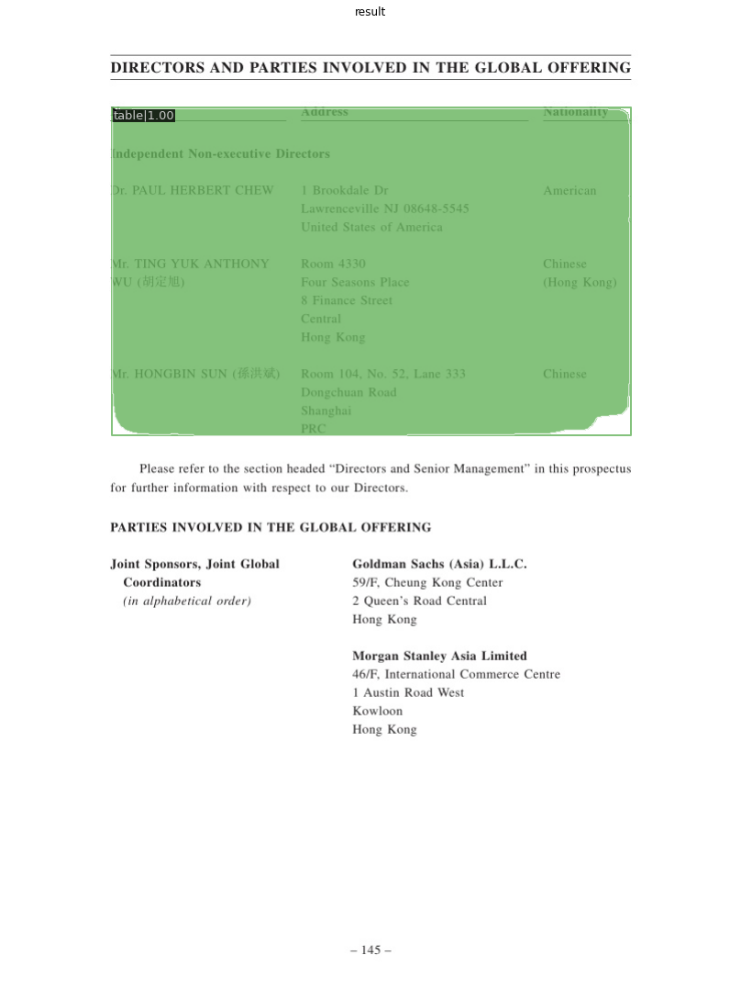

In [11]:
from mmdet.apis import inference_detector, init_detector, show_result_pyplot
# Use the detector to do inference
img = '/content/Document_Image_Table_Detection-/data/trackA_modern/train/cTDaR_t10000.jpg'
result = inference_detector(model, img)
# Let's plot the result

show_result_pyplot(model, img, result, score_thr=0.70)

In [14]:
CUDA_LAUNCH_BLOCKING=1
!python tools/test.py \
configs/mask_rcnn/mask_rcnn_dit_icdar2019.py \
exps/latest.pth \
--out results.pkl \
--eval bbox \
--show

/content/Document_Image_Table_Detection-/mmdet/utils/setup_env.py:39: UserWarning: Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed.
  f'Setting OMP_NUM_THREADS environment variable for each process '
/content/Document_Image_Table_Detection-/mmdet/utils/setup_env.py:49: UserWarning: Setting MKL_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed.
  f'Setting MKL_NUM_THREADS environment variable for each process '
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
load checkpoint from local path: exps/latest.pth
[                                                  ] 0/240, elapsed: 0s, ETA:/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: User

In [15]:
# load tensorboard in# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir ./exps 

<IPython.core.display.Javascript object>

/usr/lib/python3.7/subprocess.py:883: ResourceWarning: subprocess 2066 is still running
  ResourceWarning, source=self)
